# CASE3 | Shift random, |x|<0.1

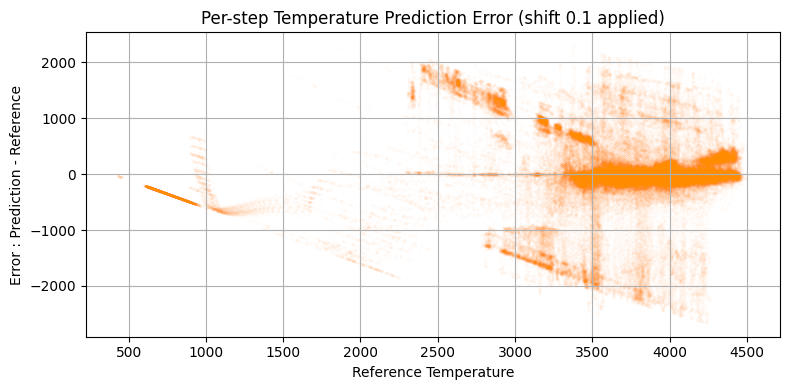

In [6]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import os

# ── Directory of saved outputs ───────────────────────
load_dir = "/home/ftk3187/github/DPC_research/02_DED/4_policy_0725/simulation_outputs_case3_onlyshift"
laser_numbers = list(range(2, 50))

# ── 저장용 리스트 ──────────────────────────────────────
ref_temp_all = []
abs_error_all = []

for laser_num in laser_numbers:
    try:
        # Load files
        ref_path = os.path.join(load_dir, f"ref_laser_{laser_num}.csv")
        x_path   = os.path.join(load_dir, f"x_outputs_laser_{laser_num}.csv")

        ref_df = pd.read_csv(ref_path)
        x_df = pd.read_csv(x_path)

        # Extract first column (melt pool temperature)
        ref_temp = ref_df.iloc[:, 0].values
        pred_temp = x_df.iloc[:, 0].values

        # Trim to same length
        min_len = min(len(ref_temp), len(pred_temp))
        ref_temp = ref_temp[:min_len]
        pred_temp = pred_temp[:min_len]

        # Compute absolute error or squared error
        abs_error = (pred_temp - ref_temp)

        # Accumulate for all lasers
        ref_temp_all.append(ref_temp)
        abs_error_all.append(abs_error)

    except Exception as e:
        pass #print(f"❌ Error processing laser {laser_num}: {e}")

# ── Concatenate all points ────────────────────────────
ref_temp_all = np.concatenate(ref_temp_all)
abs_error_all = np.concatenate(abs_error_all)

# ── Scatter plot ──────────────────────────────────────
plt.figure(figsize=(8,4))
plt.scatter(ref_temp_all, abs_error_all, s=0.001, alpha=0.5, color='darkorange')
plt.xlabel("Reference Temperature")
plt.ylabel("Error : Prediction - Reference")
plt.title("Per-step Temperature Prediction Error (shift 0.1 applied)")
plt.grid(True)
plt.tight_layout()
plt.show()


# CASE11 | CASE3 + Smoothness=1

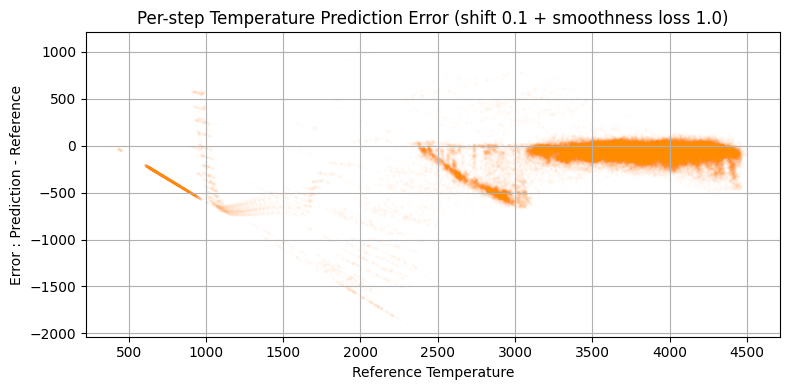

In [3]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import os

# ── Directory of saved outputs ───────────────────────
load_dir = "/home/ftk3187/github/DPC_research/02_DED/4_policy_0725/simulation_outputs_case11_smoothness=1"
laser_numbers = list(range(2, 50))

# ── 저장용 리스트 ──────────────────────────────────────
ref_temp_all = []
abs_error_all = []

for laser_num in laser_numbers:
    try:
        # Load files
        ref_path = os.path.join(load_dir, f"ref_laser_{laser_num}.csv")
        x_path   = os.path.join(load_dir, f"x_outputs_laser_{laser_num}.csv")

        ref_df = pd.read_csv(ref_path)
        x_df = pd.read_csv(x_path)

        # Extract first column (melt pool temperature)
        ref_temp = ref_df.iloc[:, 0].values
        pred_temp = x_df.iloc[:, 0].values

        # Trim to same length
        min_len = min(len(ref_temp), len(pred_temp))
        ref_temp = ref_temp[:min_len]
        pred_temp = pred_temp[:min_len]

        # Compute absolute error or squared error
        abs_error = (pred_temp - ref_temp)

        # Accumulate for all lasers
        ref_temp_all.append(ref_temp)
        abs_error_all.append(abs_error)

    except Exception as e:
        pass#print(f"❌ Error processing laser {laser_num}: {e}")

# ── Concatenate all points ────────────────────────────
ref_temp_all = np.concatenate(ref_temp_all)
abs_error_all = np.concatenate(abs_error_all)

# ── Scatter plot ──────────────────────────────────────
plt.figure(figsize=(8, 4))
plt.scatter(ref_temp_all, abs_error_all, s=0.001, alpha=0.5, color='darkorange')
plt.xlabel("Reference Temperature")
plt.ylabel("Error : Prediction - Reference")
plt.title("Per-step Temperature Prediction Error (shift 0.1 + smoothness loss 1.0)")
plt.grid(True)
plt.tight_layout()
plt.show()


# CASE12 | CASE11 + Oversampling

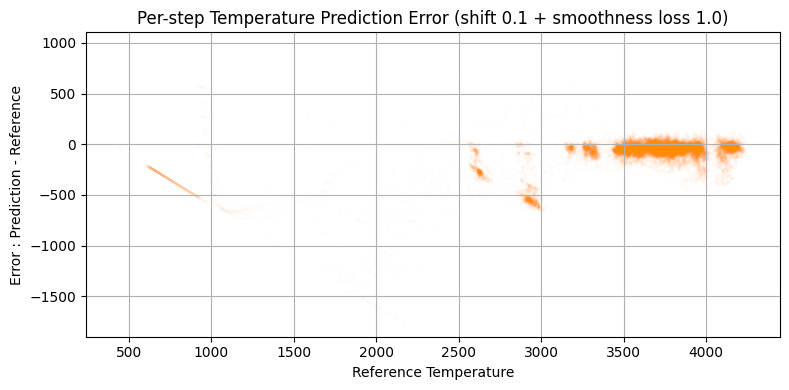

In [10]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import os

# ── Directory of saved outputs ───────────────────────
load_dir = "/home/ftk3187/github/DPC_research/02_DED/4_policy_0725/simulation_outputs_case12_oversampling"
laser_numbers = list(range(40, 50))

# ── 저장용 리스트 ──────────────────────────────────────
ref_temp_all = []
abs_error_all = []

for laser_num in laser_numbers:
    try:
        # Load files
        ref_path = os.path.join(load_dir, f"ref_laser_{laser_num}.csv")
        x_path   = os.path.join(load_dir, f"x_outputs_laser_{laser_num}.csv")

        ref_df = pd.read_csv(ref_path)
        x_df = pd.read_csv(x_path)

        # Extract first column (melt pool temperature)
        ref_temp = ref_df.iloc[:, 0].values
        pred_temp = x_df.iloc[:, 0].values

        # Trim to same length
        min_len = min(len(ref_temp), len(pred_temp))
        ref_temp = ref_temp[:min_len]
        pred_temp = pred_temp[:min_len]

        # Compute absolute error or squared error
        abs_error = (pred_temp - ref_temp)

        # Accumulate for all lasers
        ref_temp_all.append(ref_temp)
        abs_error_all.append(abs_error)

    except Exception as e:
        pass#print(f"❌ Error processing laser {laser_num}: {e}")

# ── Concatenate all points ────────────────────────────
ref_temp_all = np.concatenate(ref_temp_all)
abs_error_all = np.concatenate(abs_error_all)

# ── Scatter plot ──────────────────────────────────────
plt.figure(figsize=(8, 4))
plt.scatter(ref_temp_all, abs_error_all, s=0.001, alpha=0.5, color='darkorange')
plt.xlabel("Reference Temperature")
plt.ylabel("Error : Prediction - Reference")
plt.title("Per-step Temperature Prediction Error (shift 0.1 + smoothness loss 1.0)")
plt.grid(True)
plt.tight_layout()
plt.show()


In [7]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import os
import re

def plot_saved_outputs(save_dir, laser_num, N_step=None):
    # Load data
    x_path = os.path.join(save_dir, f"x_outputs_laser_{laser_num}.csv")
    u_path = os.path.join(save_dir, f"u_outputs_laser_{laser_num}.csv")
    ref_path = os.path.join(save_dir, f"ref_laser_{laser_num}.csv")

    try:
        x = pd.read_csv(x_path).values
        u = pd.read_csv(u_path).values
        ref = pd.read_csv(ref_path).values.flatten()

        if N_step is None:
            N_step = min(len(x), len(u), len(ref))

        plt.figure(figsize=[10, 6])
        plt.suptitle(f"Laser Power Number: {laser_num}", fontsize=14)

        # ─── 1. Melt Pool Temperature ──────────────────────────────
        plt.subplot(3, 1, 1)
        plt.plot(x[:N_step, 0], label="GAMMA simulation")
        plt.plot(ref[:N_step], label="Reference")
        for yline in [2000, 3000, 4000]:
            plt.axhline(y=yline, color='gray', linestyle='--', linewidth=0.8)
        plt.legend()
        plt.xlabel("MPC time step")
        plt.ylabel("Melt Pool Temp (K)")

        # ─── 2. Melt Pool Depth ───────────────────────────────────
        plt.subplot(3, 1, 2)
        plt.plot(x[:N_step, 1], label="GAMMA simulation")
        plt.axhline(y=0.225, linestyle='--', color='r', label="Upper Bound")
        plt.axhline(y=0.075, linestyle='--', color='r', label="Lower Bound")
        plt.legend()
        plt.xlabel("MPC time step")
        plt.ylabel("Melt Pool Depth (mm)")

        # ─── 3. Laser Power ───────────────────────────────────────
        plt.subplot(3, 1, 3)
        plt.plot(u[:N_step])
        for yline in [500, 600, 700]:
            plt.axhline(y=yline, color='gray', linestyle='--', linewidth=0.8)
        plt.xlabel("MPC time step")
        plt.ylabel("Laser Power (W)")

        plt.tight_layout(rect=[0, 0, 1, 0.96])
        plt.show()

    except Exception as e:
        print(f"❌ Failed to plot for laser {laser_num}: {e}")



📌 Found laser_power_numbers: [2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97]


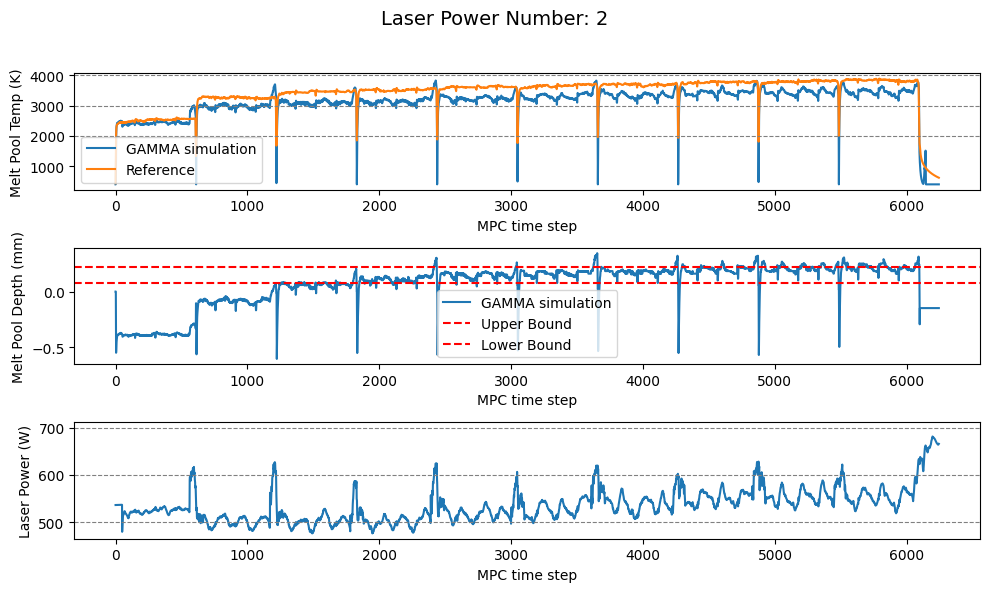

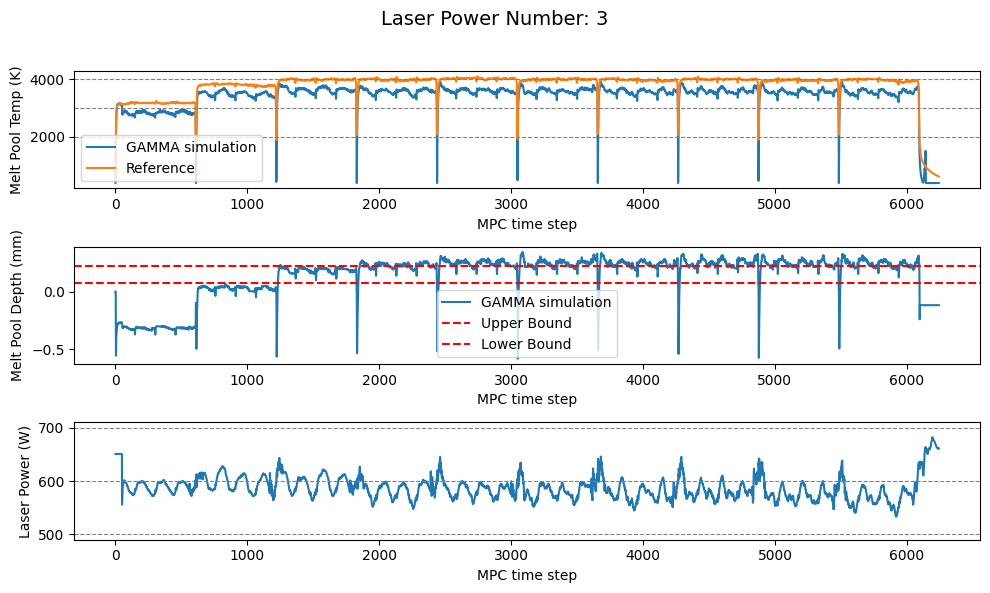

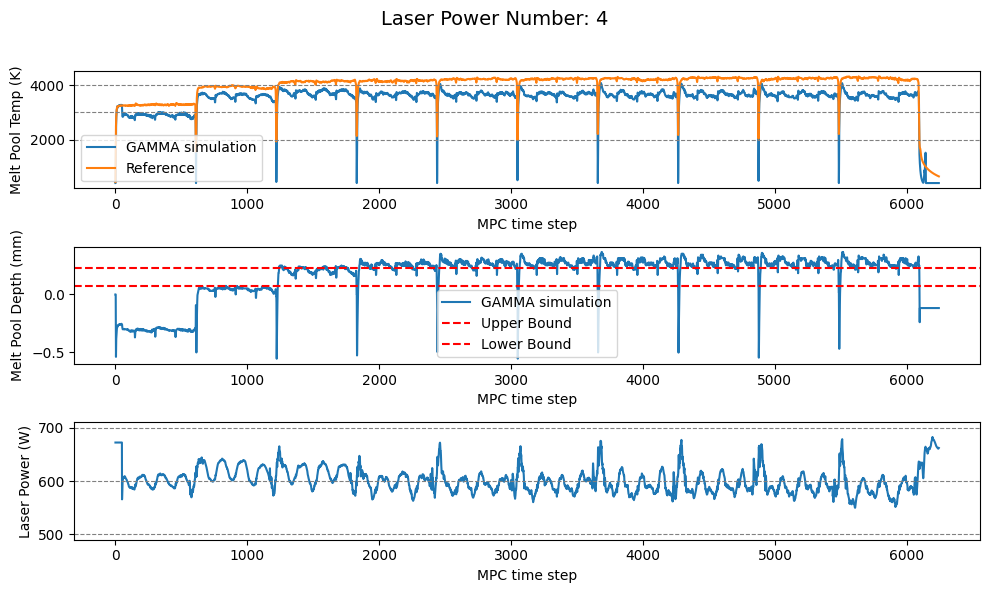

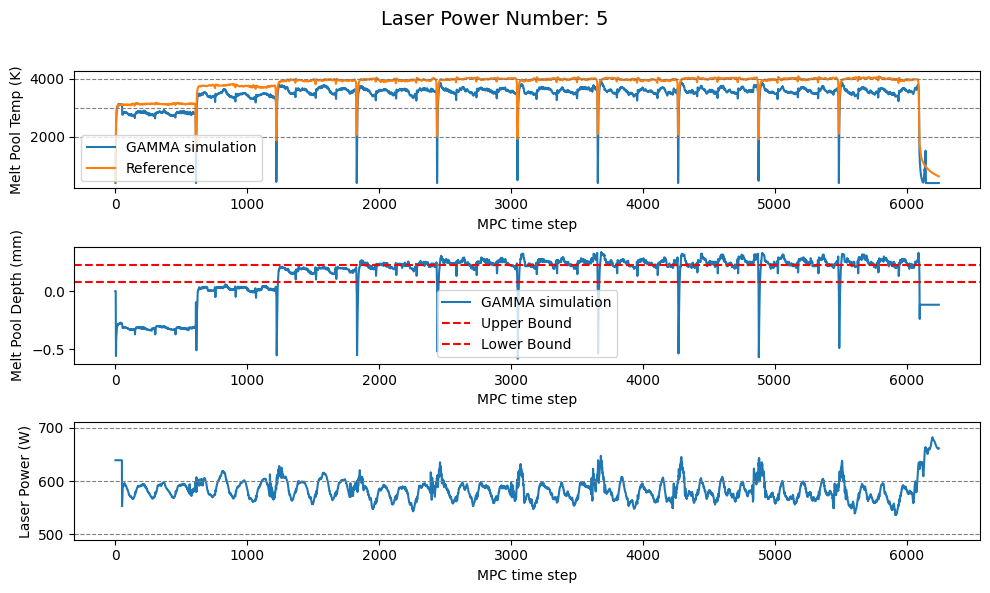

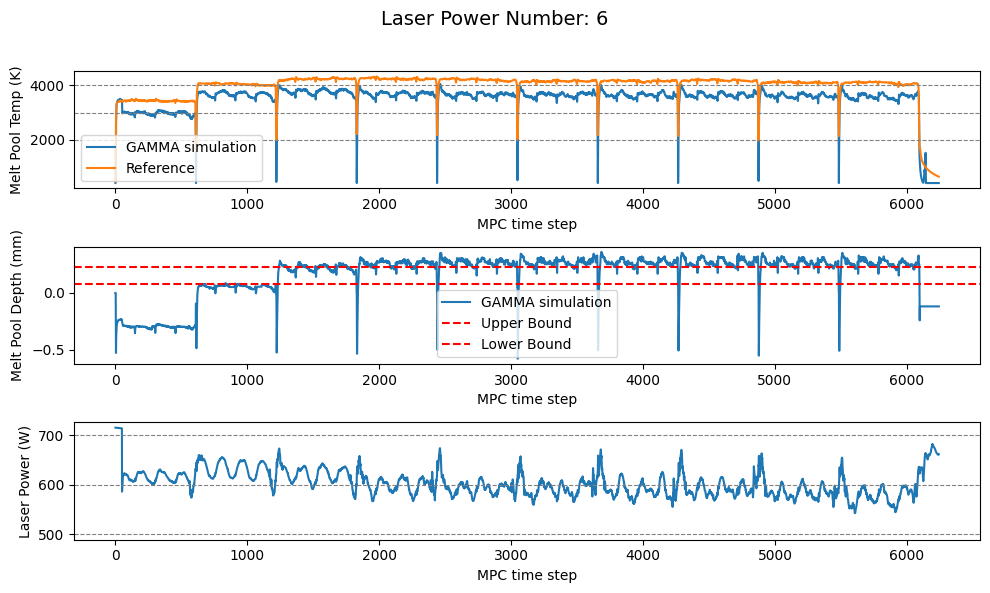

...

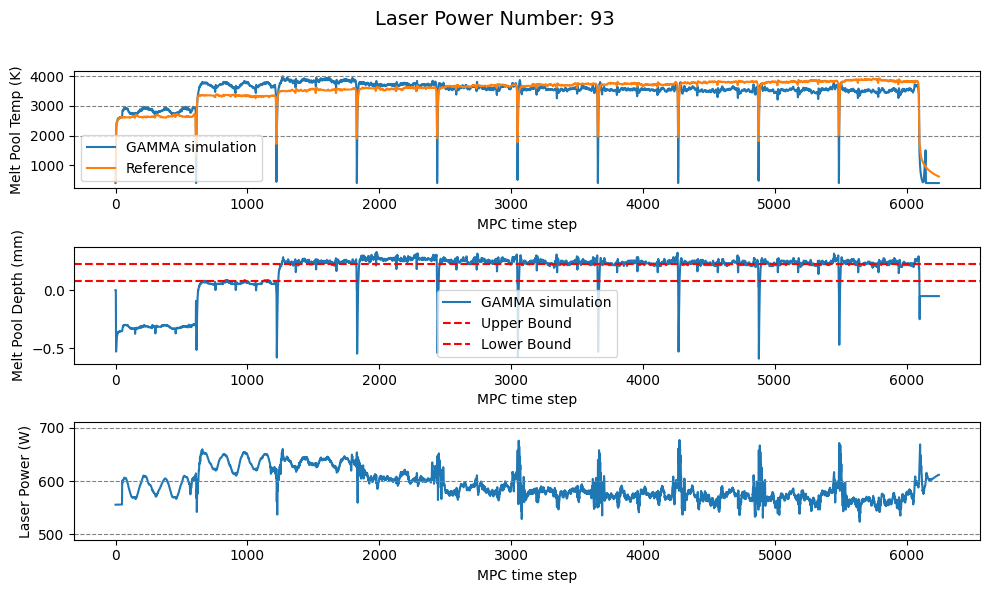

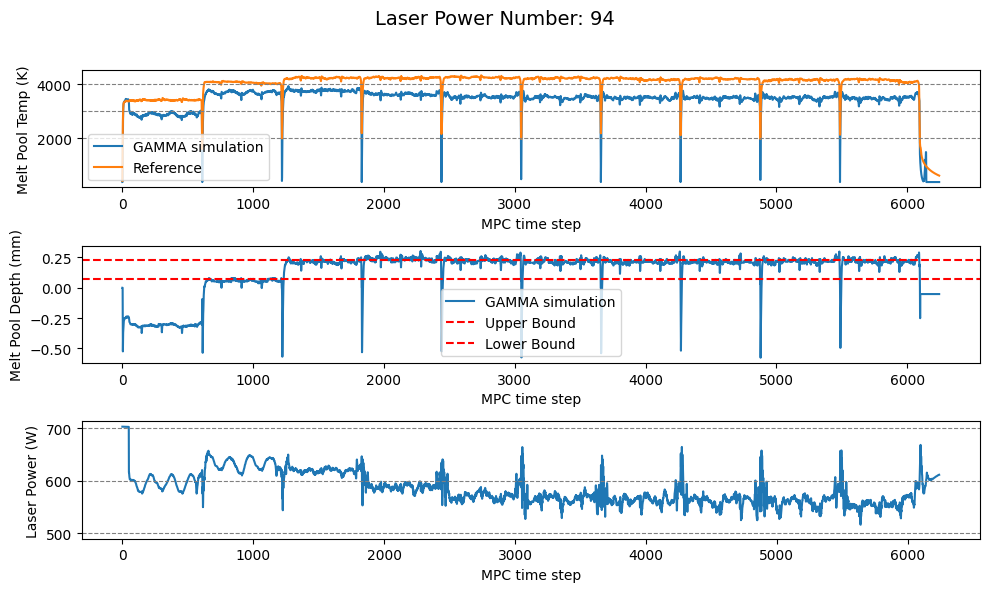

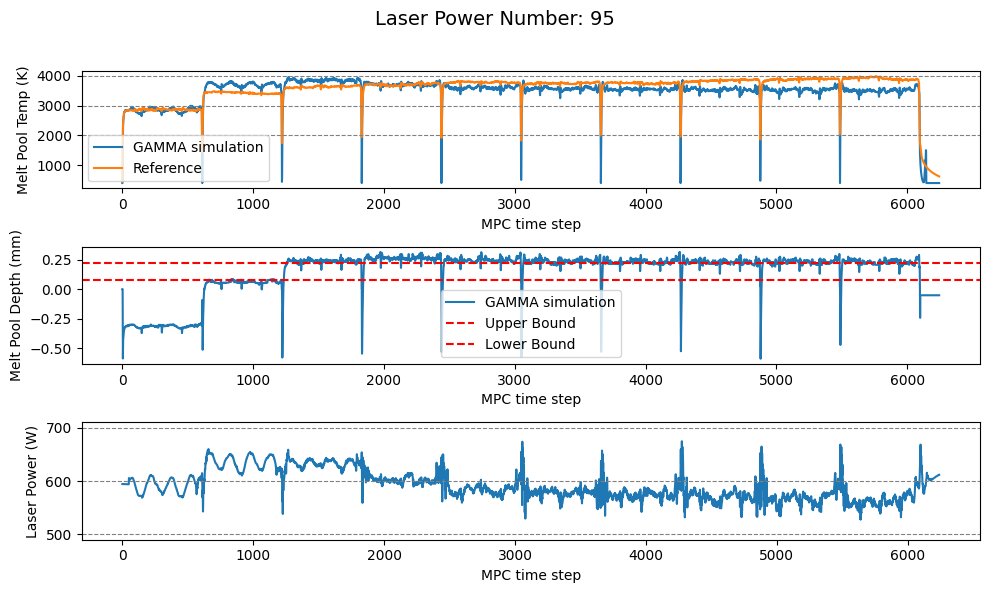

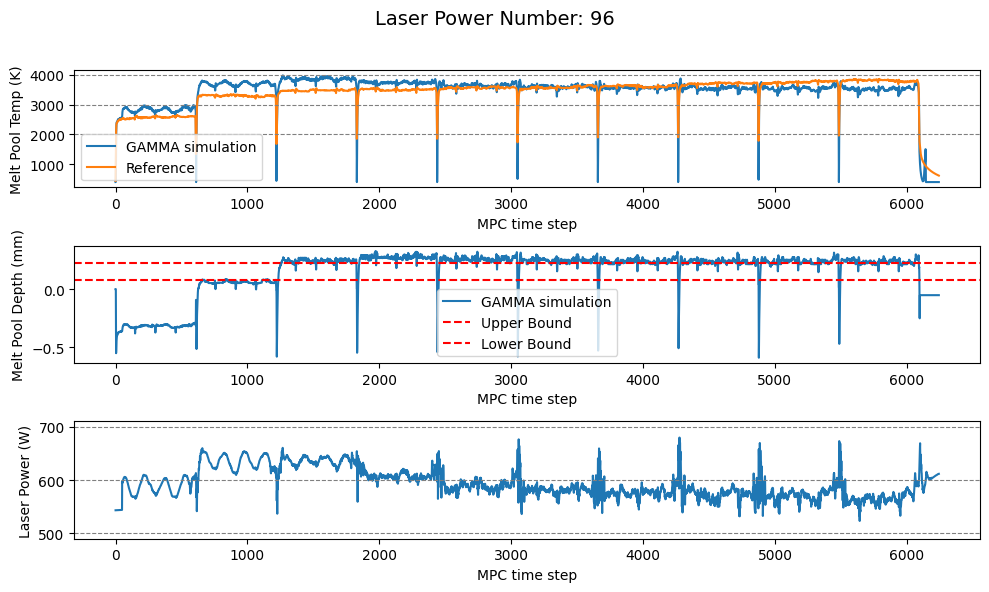

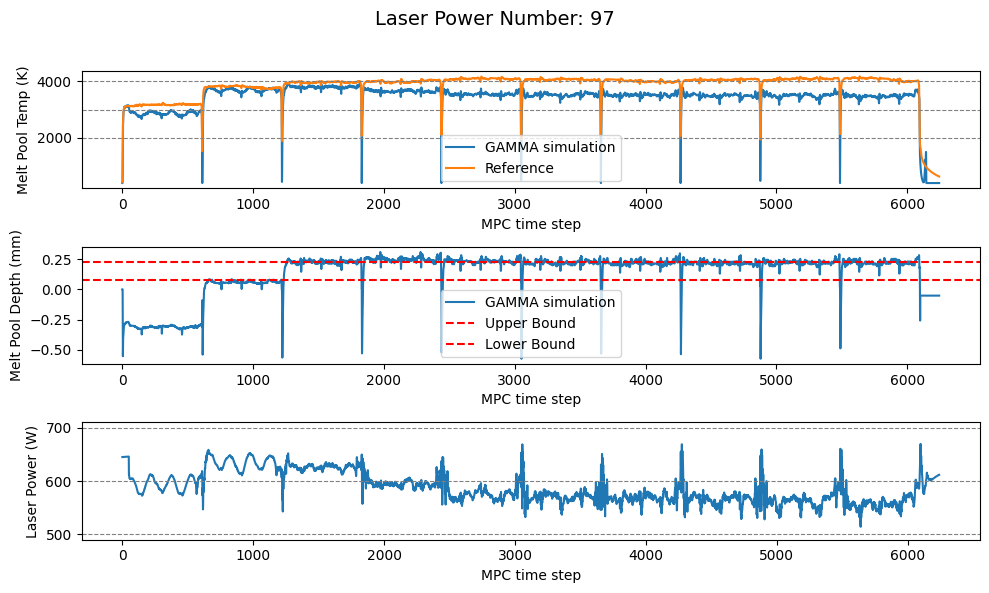

In [8]:
# ── Main Loop ───────────────────────────────────────────────
save_dir = "/home/ftk3187/github/DPC_research/02_DED/2_policy/simulation_outputs"

# Find laser_power_numbers
all_files = os.listdir(save_dir)
laser_nums = sorted(set(
    int(re.search(r"(\d+)", f).group(1))
    for f in all_files if f.startswith("x_outputs_laser_")
))

print(f"📌 Found laser_power_numbers: {laser_nums}")

# Plot all
for laser_num in laser_nums:
    plot_saved_outputs(save_dir, laser_num)

# CASE3 | Only Shift random, |x|<0.1

📌 Found laser_power_numbers: [2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73]


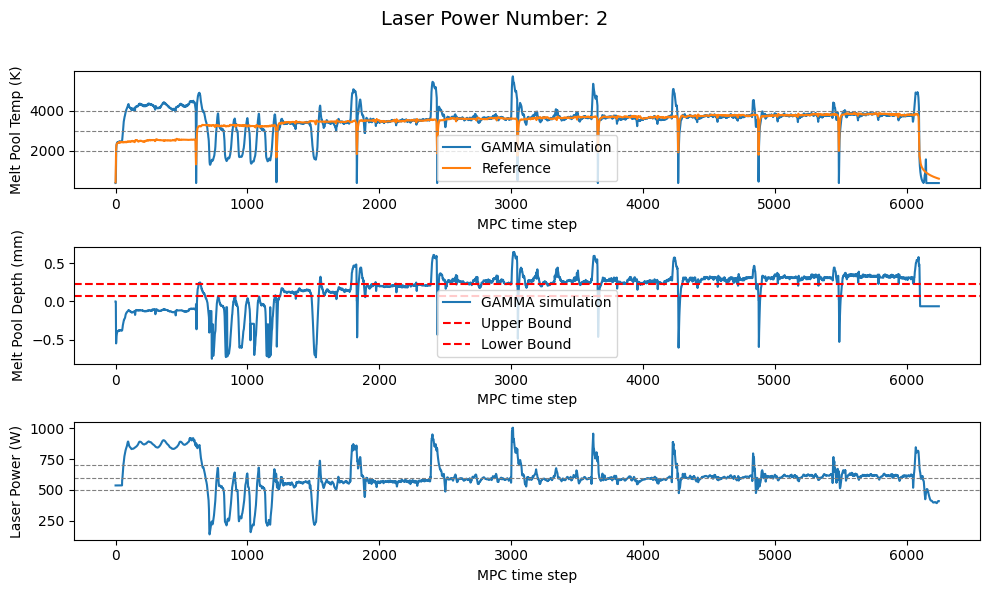

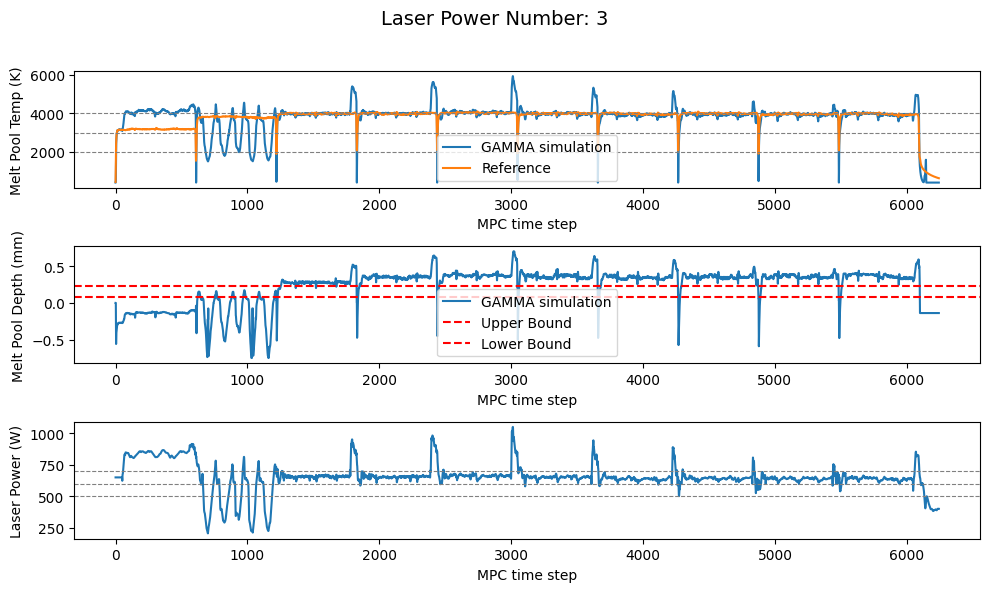

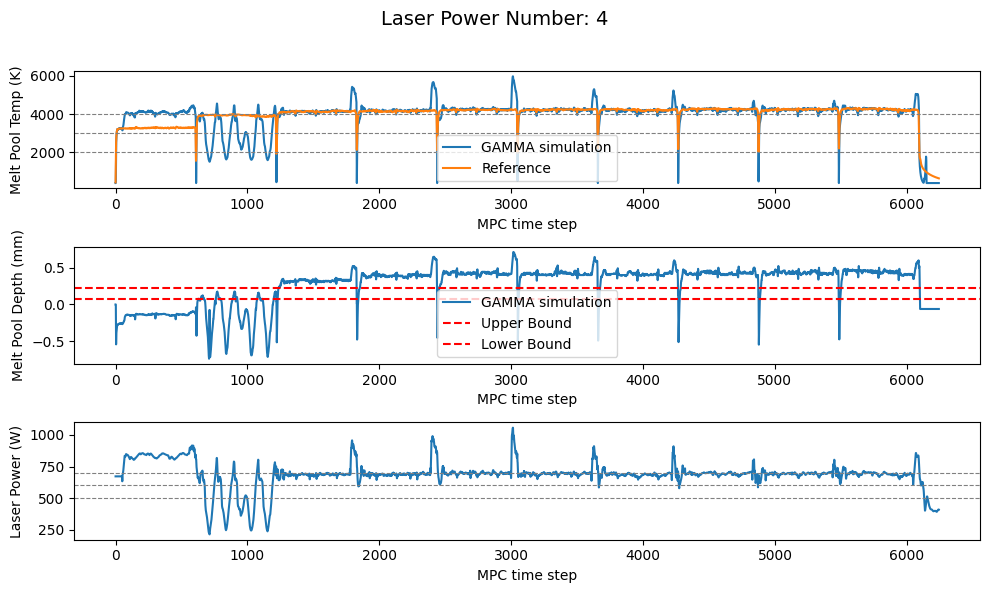

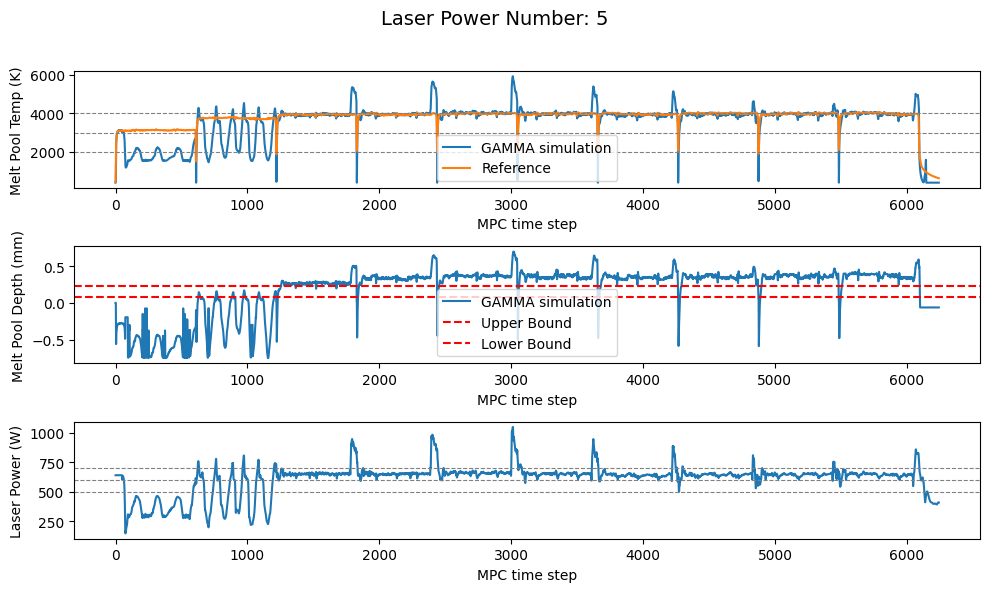

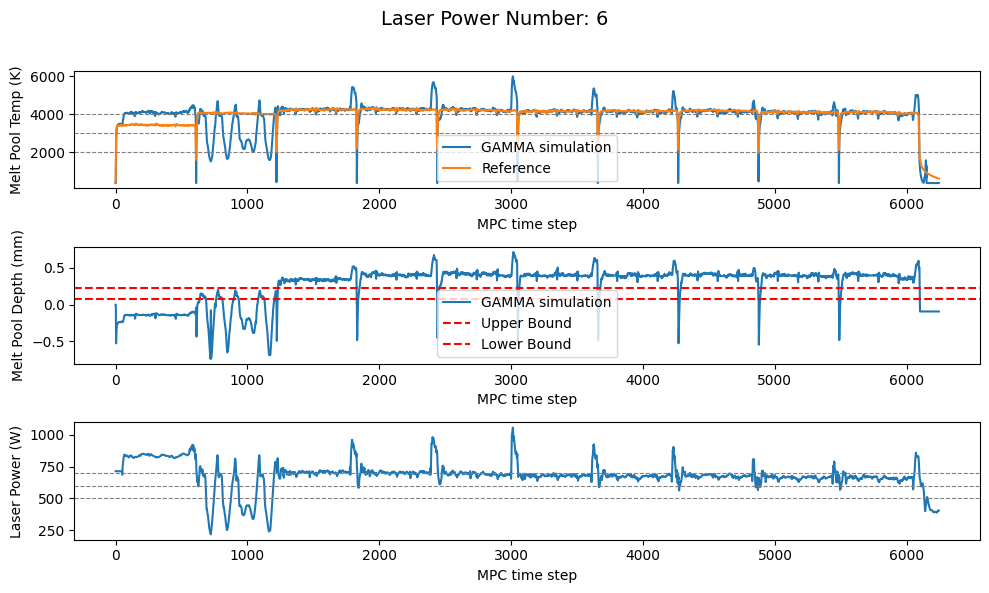

...

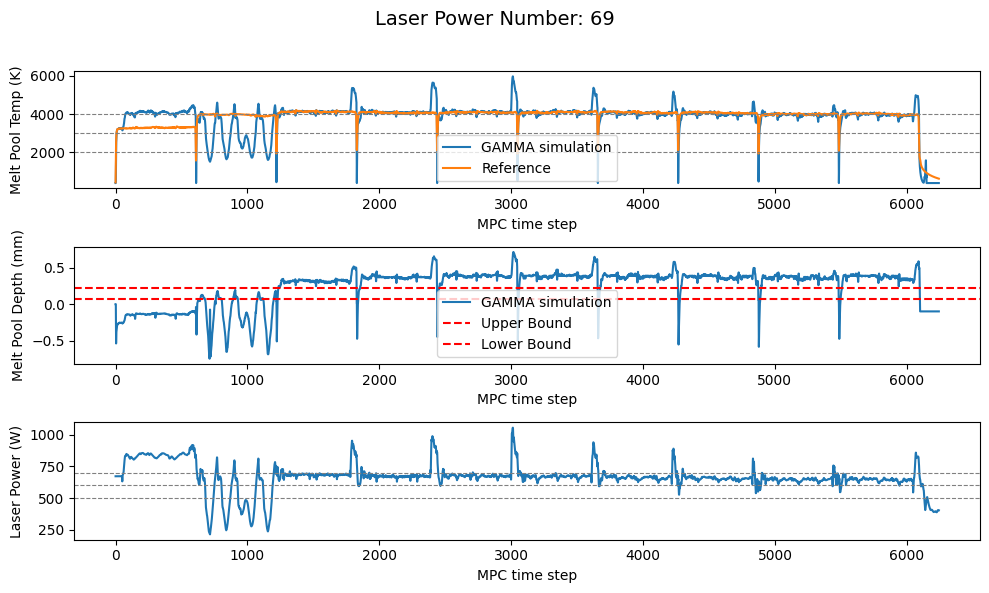

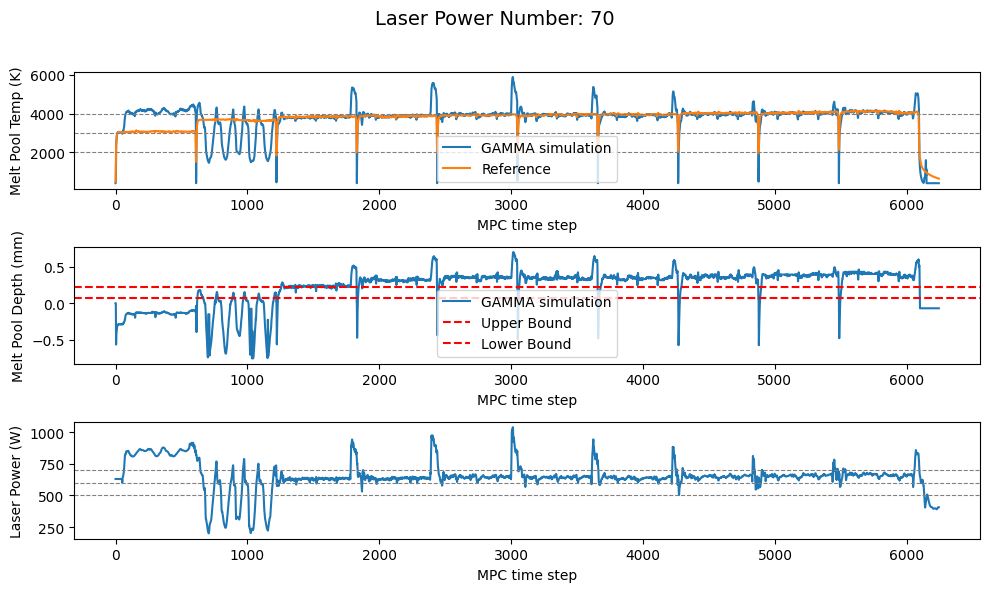

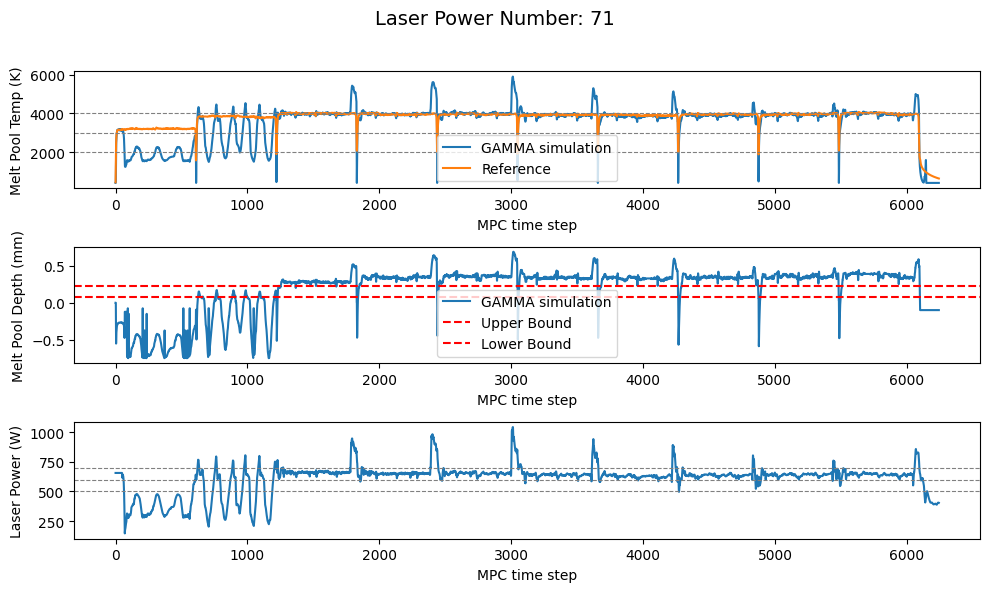

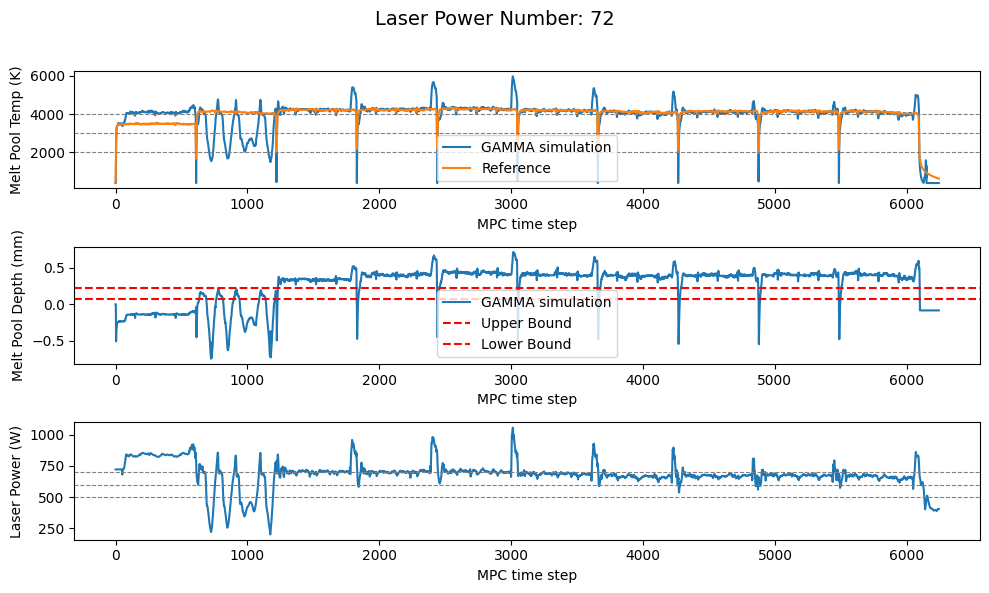

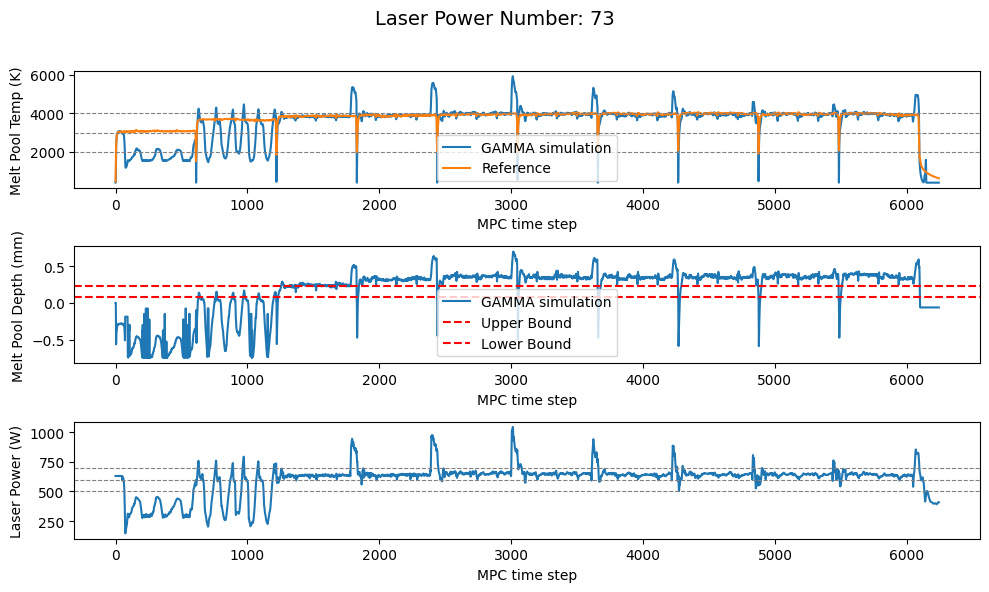

In [12]:
# ── Main Loop ───────────────────────────────────────────────
save_dir = "/home/ftk3187/github/DPC_research/02_DED/4_policy_0725/simulation_outputs_case3_onlyshift"

# Find laser_power_numbers
all_files = os.listdir(save_dir)
laser_nums = sorted(set(
    int(re.search(r"(\d+)", f).group(1))
    for f in all_files if f.startswith("x_outputs_laser_")
))

print(f"📌 Found laser_power_numbers: {laser_nums}")

# Plot all
for laser_num in laser_nums:
    plot_saved_outputs(save_dir, laser_num)

# CASE11 | CASE3 + Smoothness=1

📌 Found laser_power_numbers: [2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49]


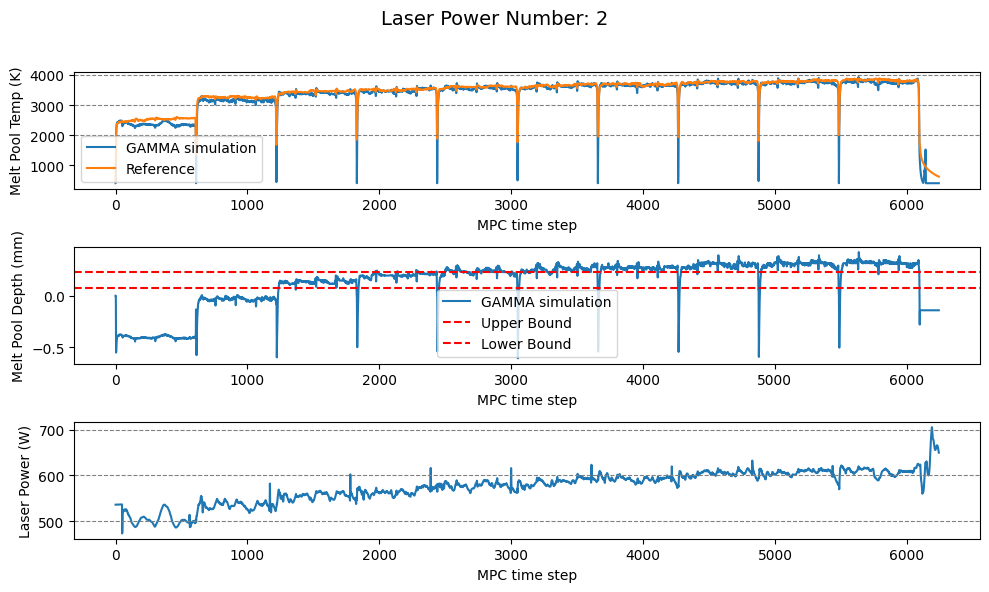

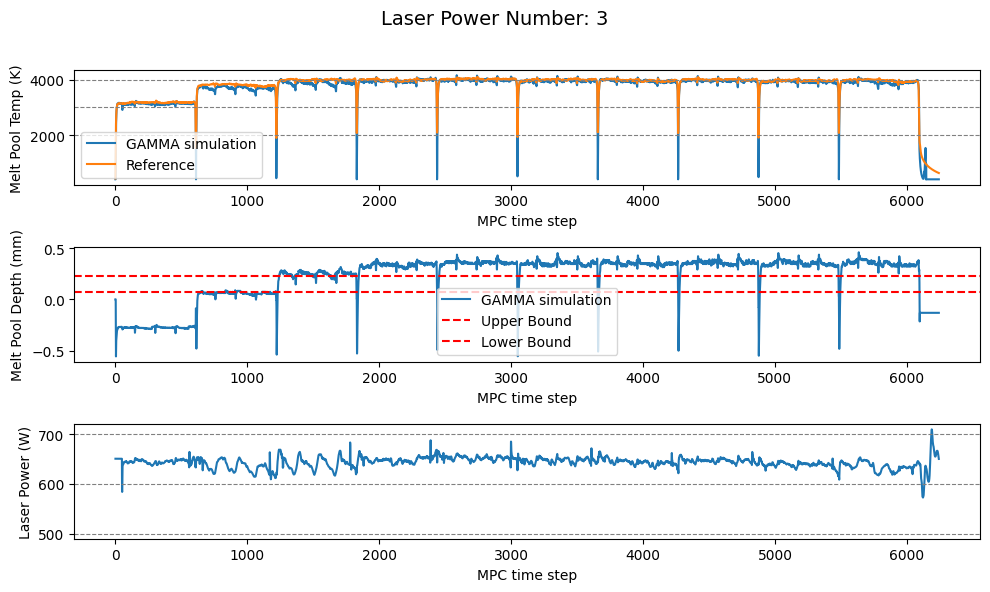

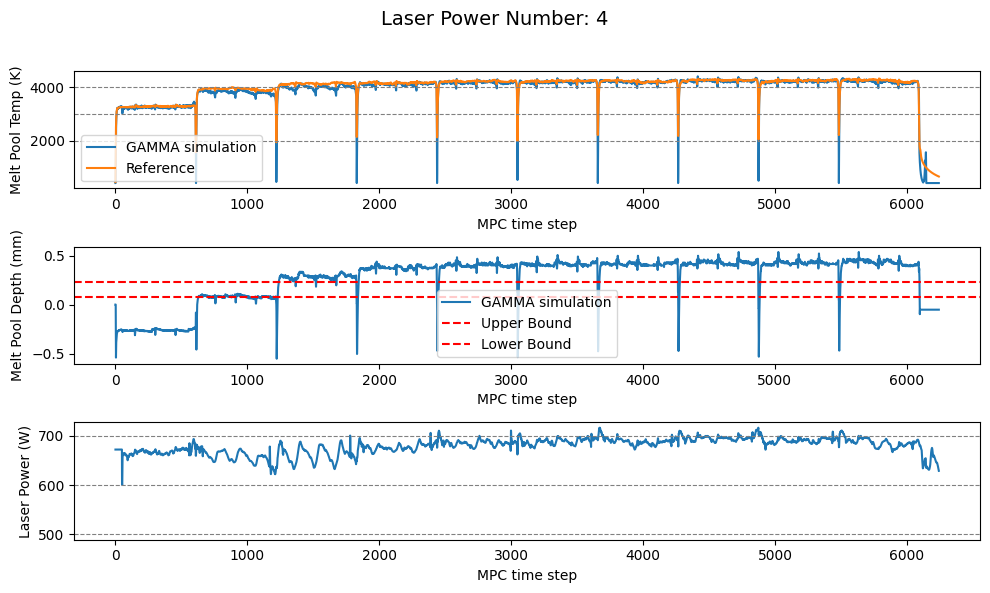

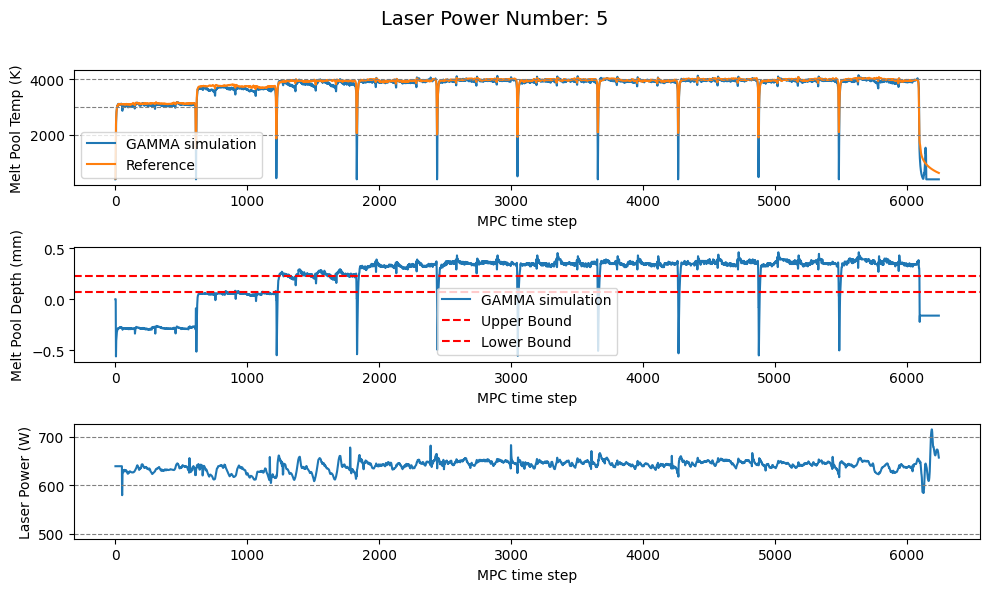

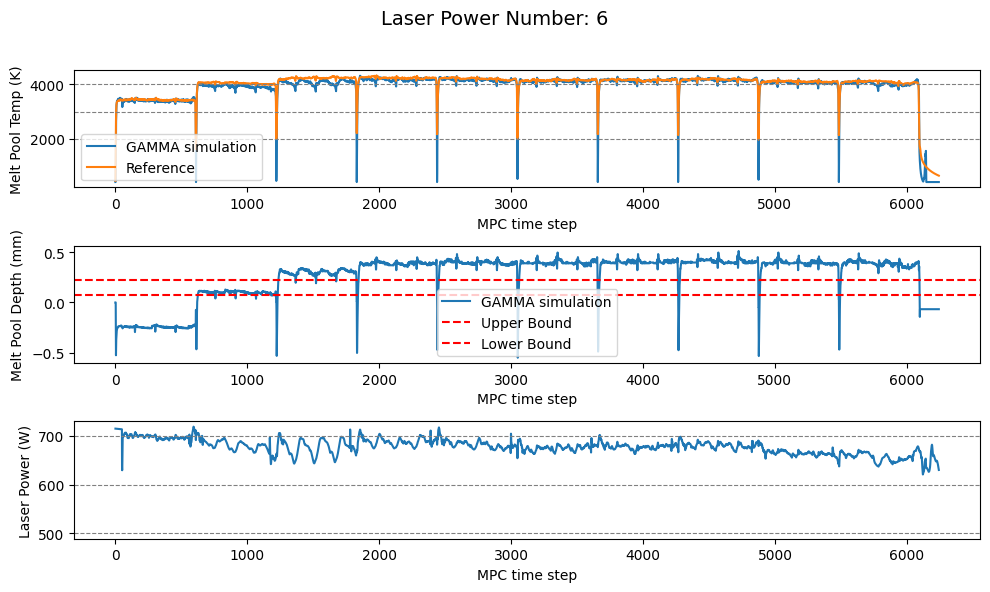

...

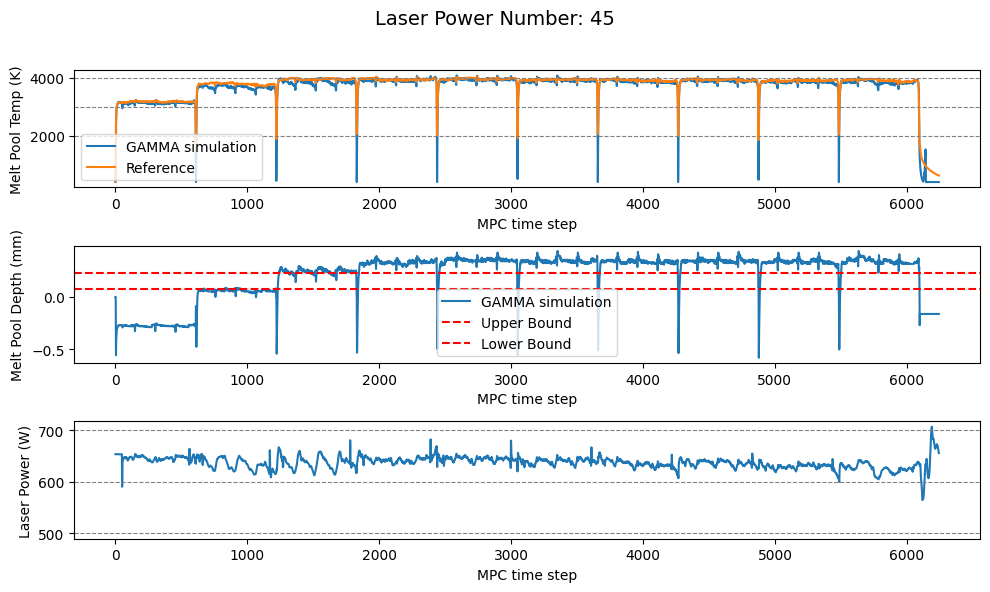

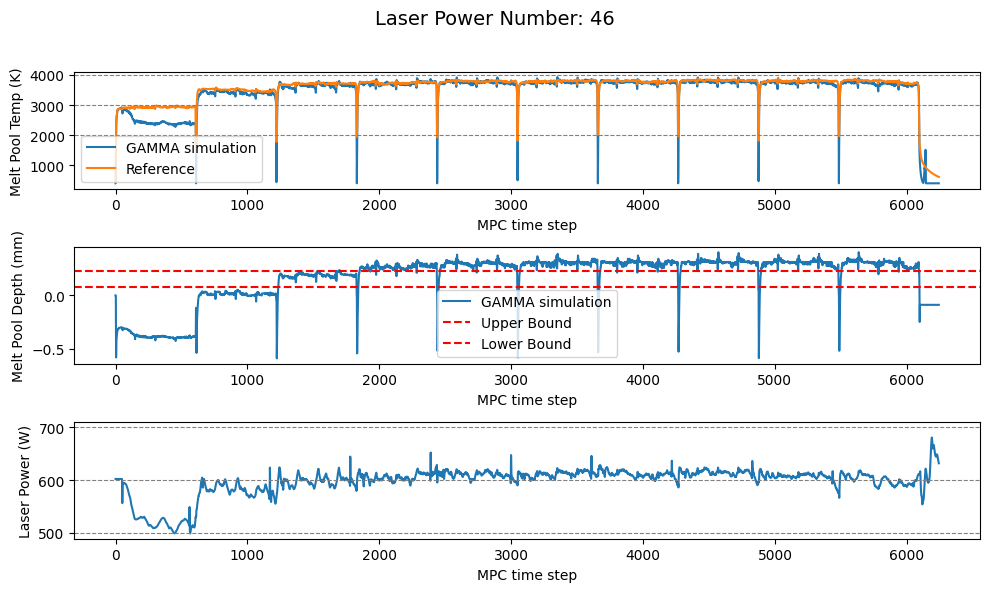

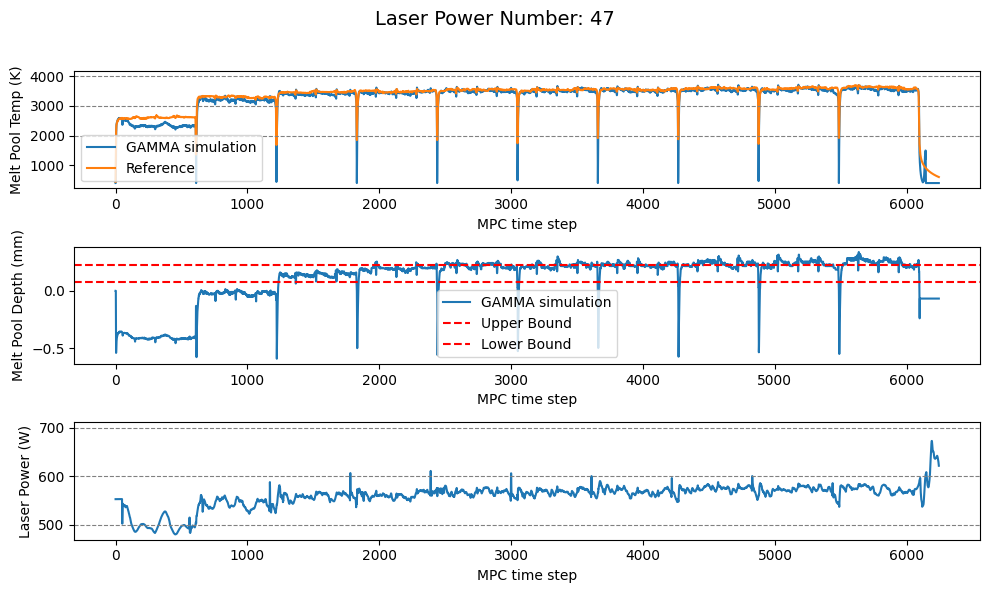

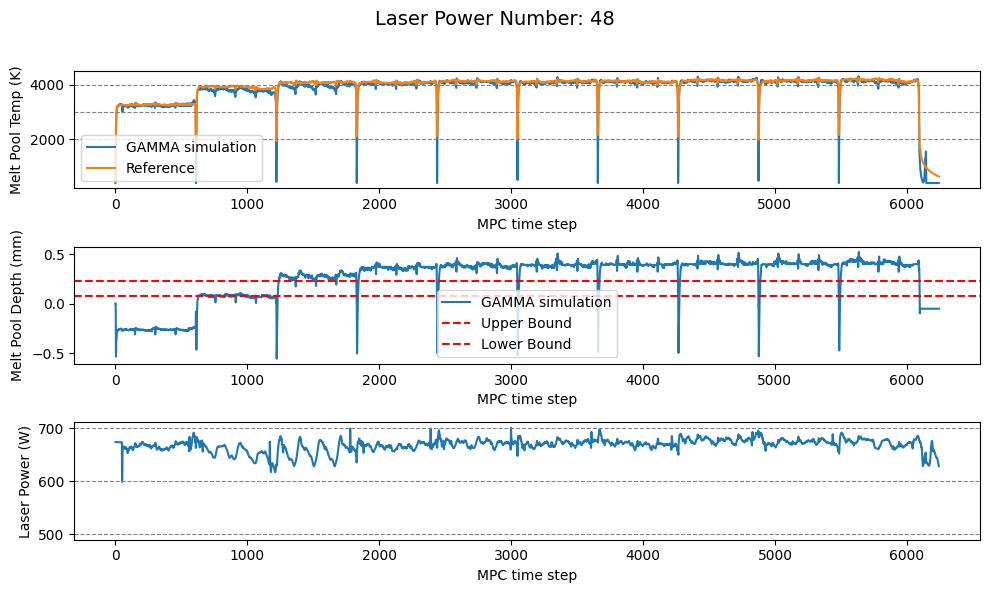

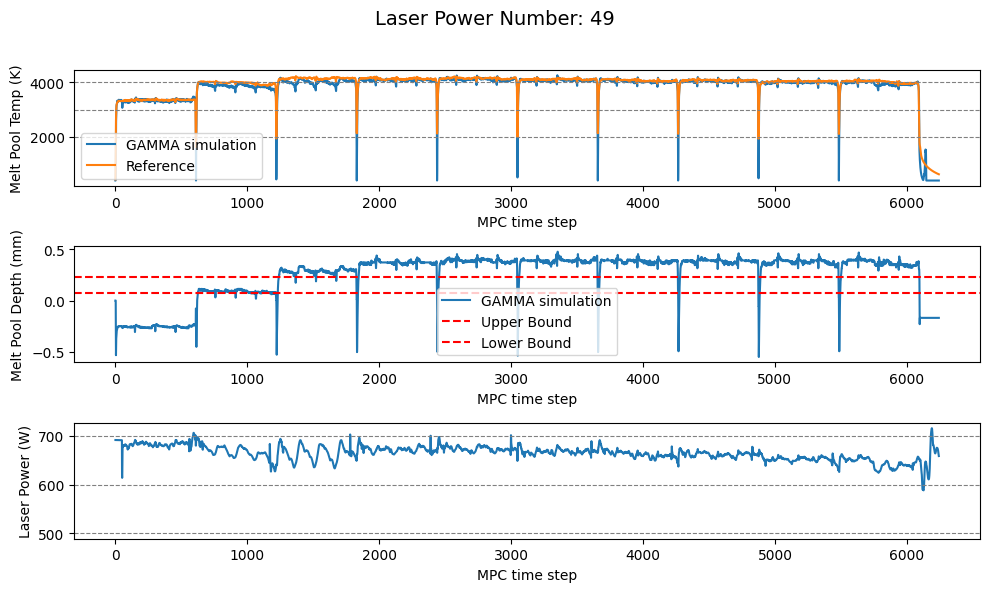

In [13]:
# ── Main Loop ───────────────────────────────────────────────
save_dir = "/home/ftk3187/github/DPC_research/02_DED/4_policy_0725/simulation_outputs_case11_smoothness=1"

# Find laser_power_numbers
all_files = os.listdir(save_dir)
laser_nums = sorted(set(
    int(re.search(r"(\d+)", f).group(1))
    for f in all_files if f.startswith("x_outputs_laser_")
))

print(f"📌 Found laser_power_numbers: {laser_nums}")

# Plot all
for laser_num in laser_nums:
    plot_saved_outputs(save_dir, laser_num)

# CASE14 | CASE11 + Constraint=1

📌 Found laser_power_numbers: [2, 3, 4, 5, 6, 7, 8, 9, 40, 41, 42, 43, 44, 45]


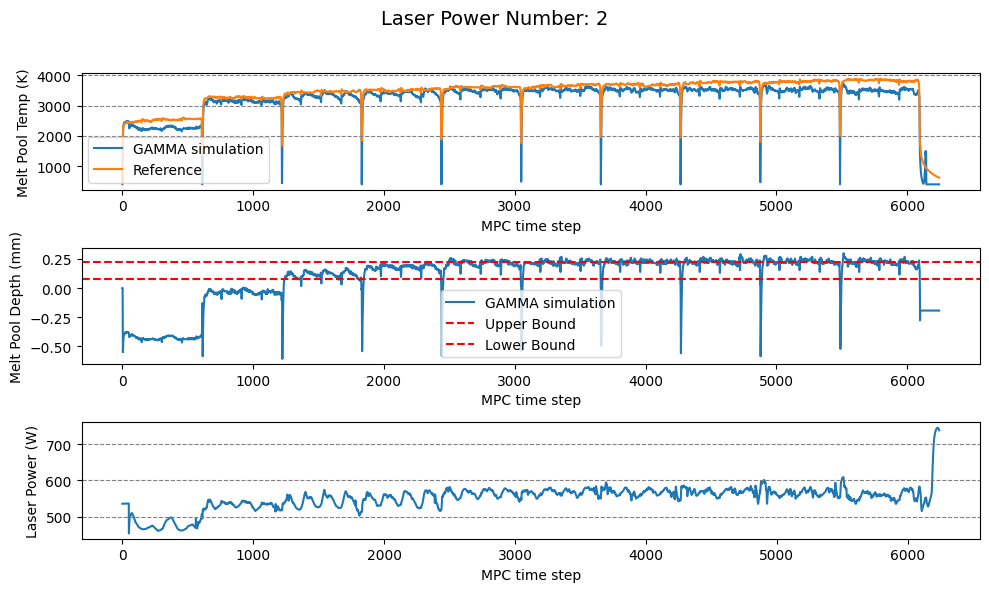

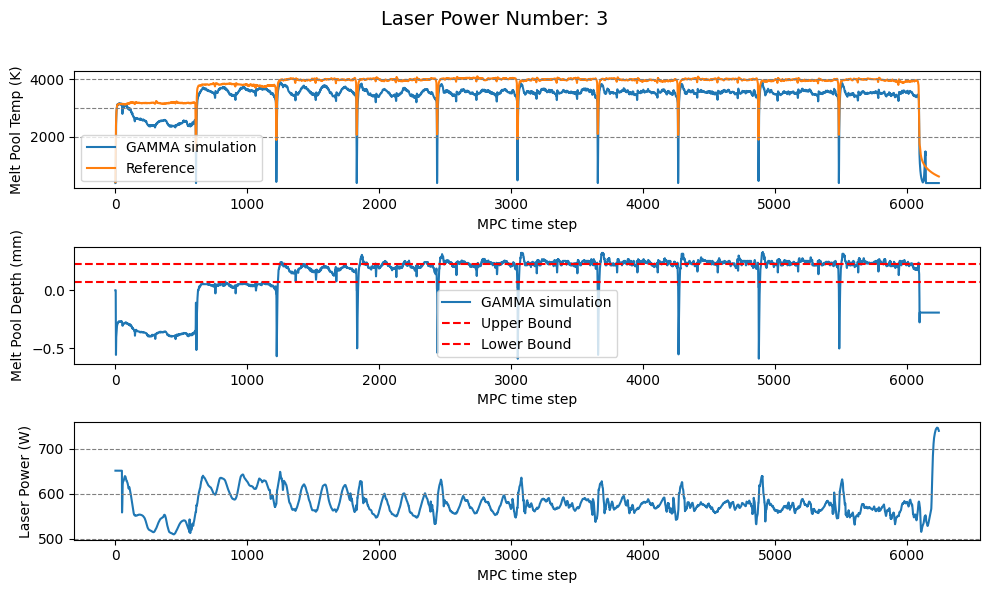

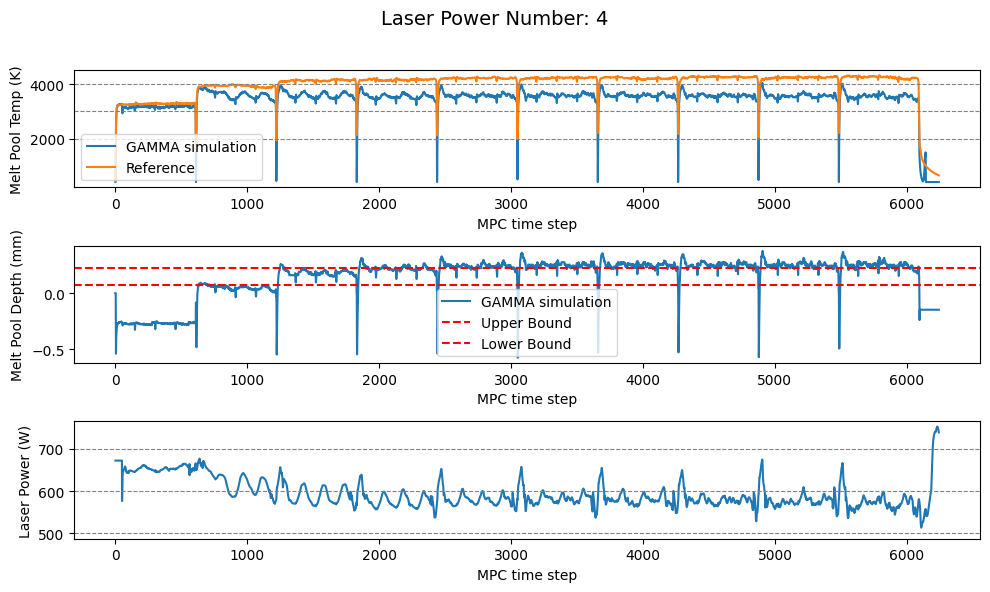

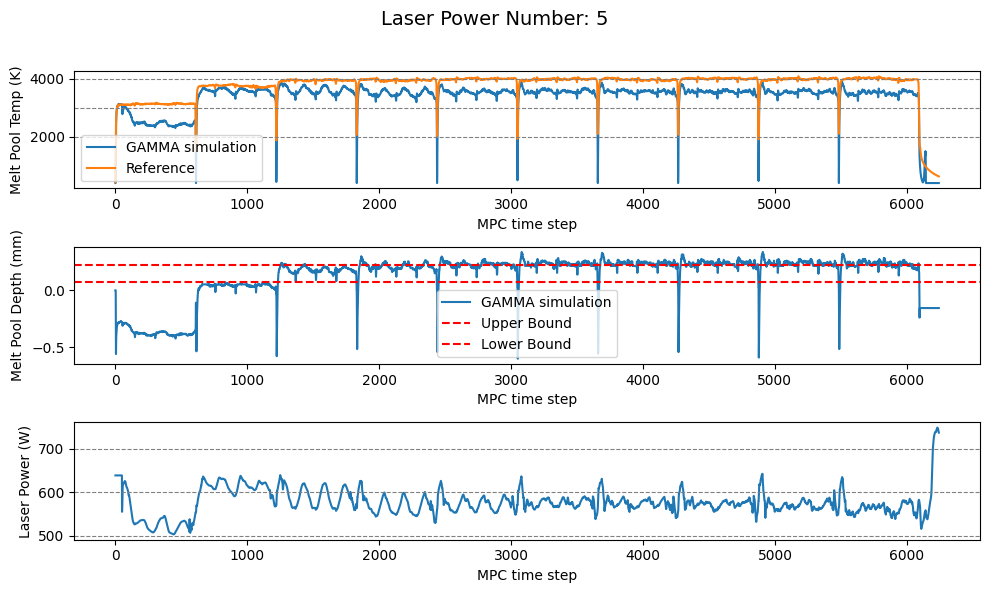

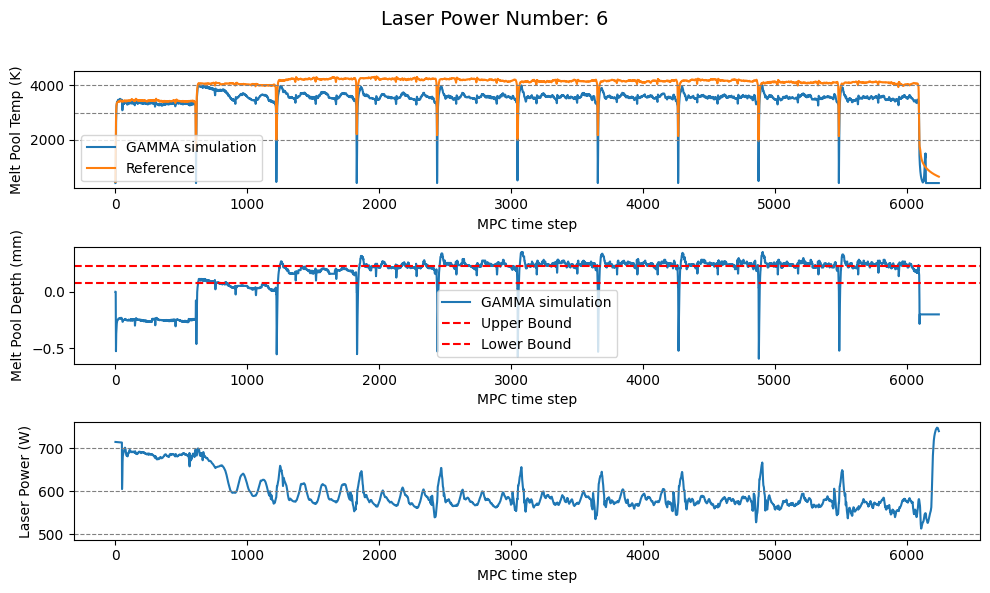

...

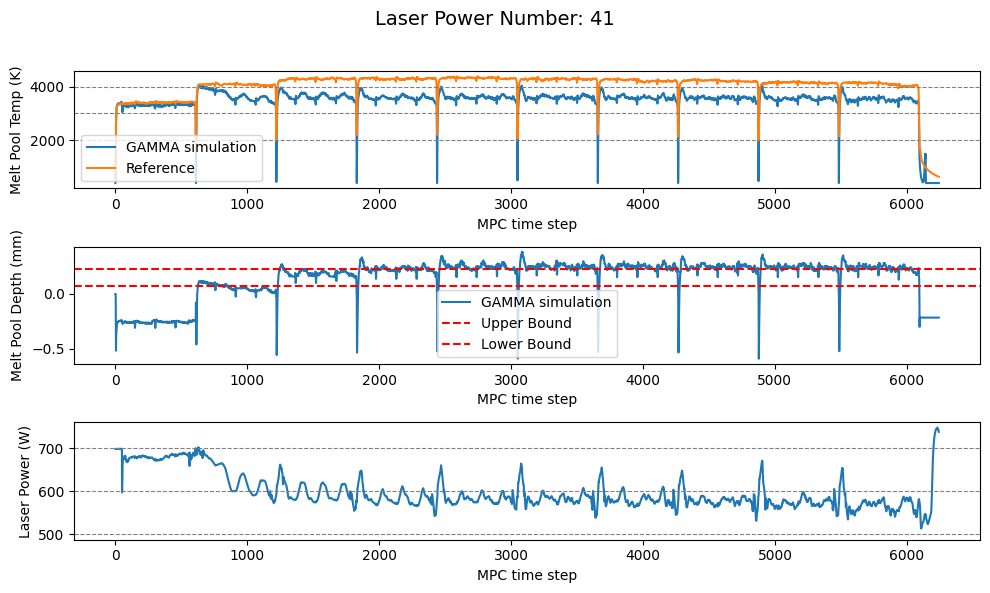

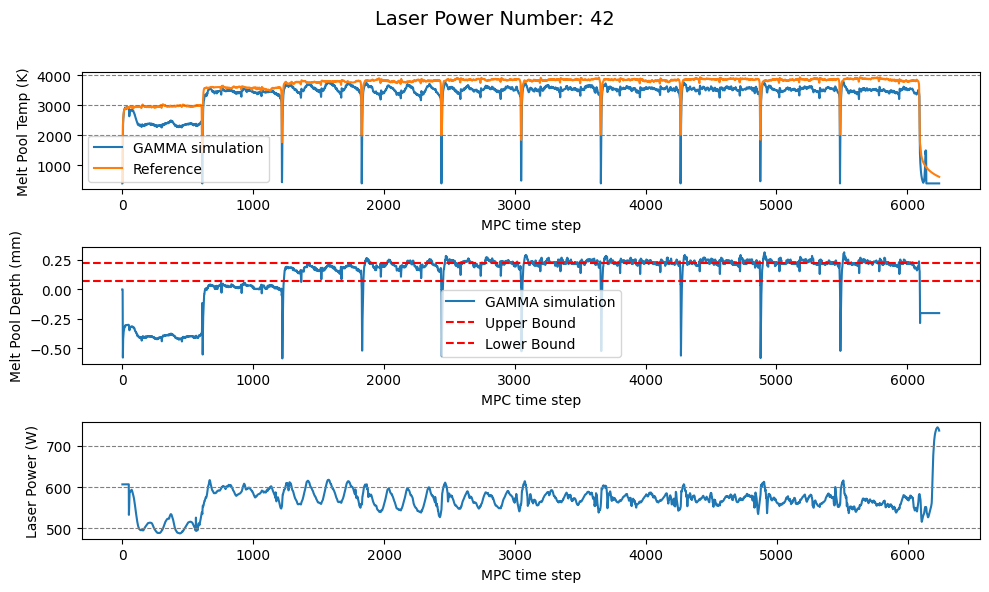

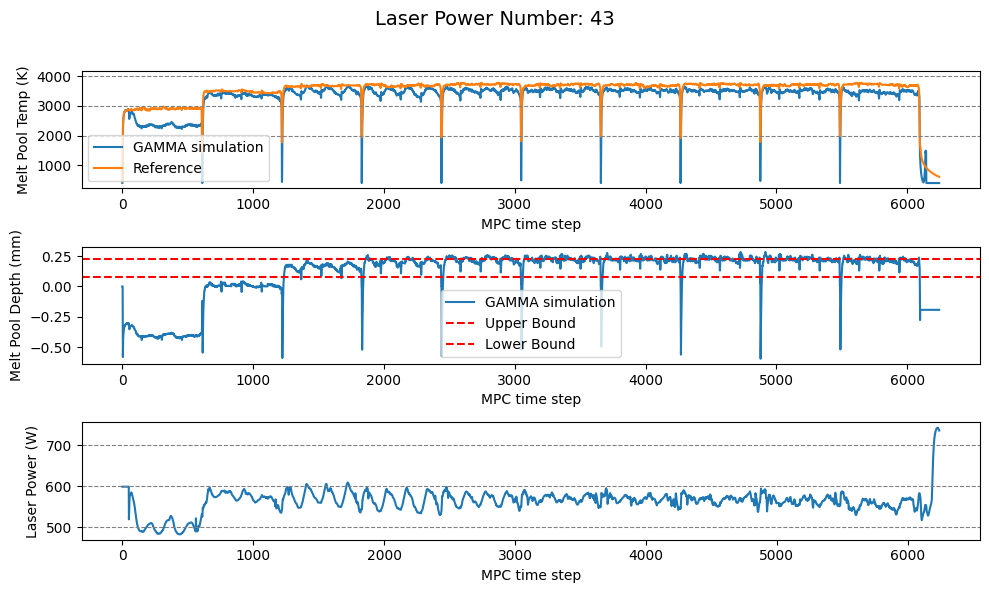

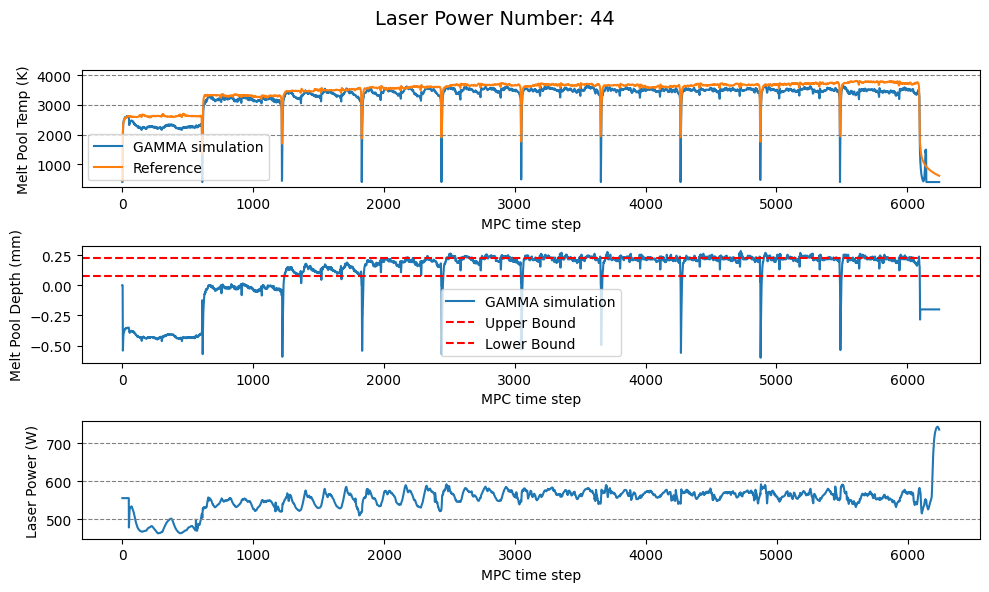

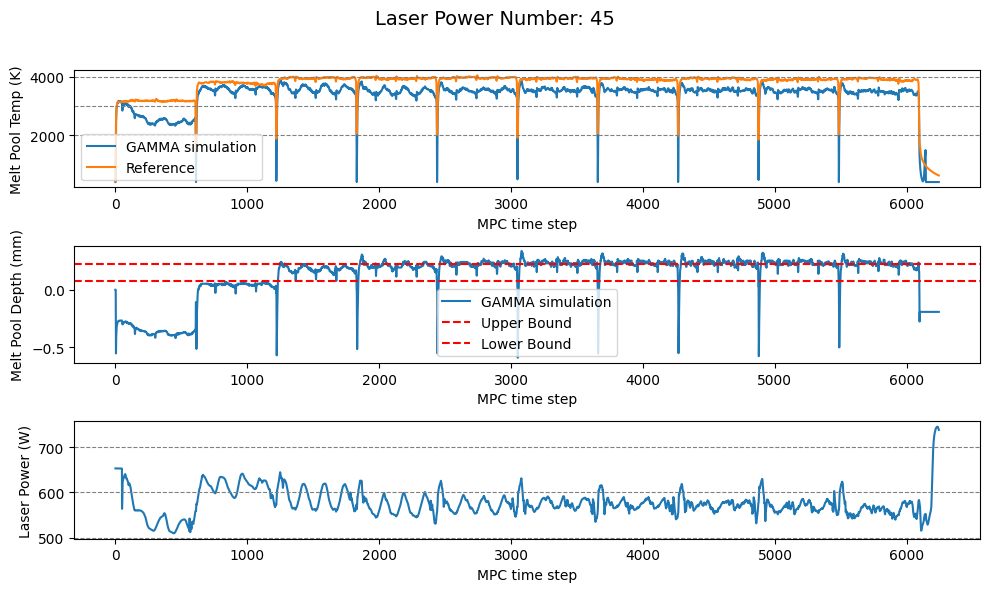

In [14]:
# ── Main Loop ───────────────────────────────────────────────
save_dir = "/home/ftk3187/github/DPC_research/02_DED/4_policy_0725/simulation_outputs_case14_smoothness_constraints=1"

# Find laser_power_numbers
all_files = os.listdir(save_dir)
laser_nums = sorted(set(
    int(re.search(r"(\d+)", f).group(1))
    for f in all_files if f.startswith("x_outputs_laser_")
))

print(f"📌 Found laser_power_numbers: {laser_nums}")

# Plot all
for laser_num in laser_nums:
    plot_saved_outputs(save_dir, laser_num)